In [1]:
# Import the usual libraries
import numpy as np
from sklearn.decomposition import PCA

In [2]:
# We import the functions that implement k-means, DBSCAN and Gaussian Mixture
from sklearn.cluster import KMeans, DBSCAN
from sklearn.mixture import GaussianMixture

In [3]:
from helper_clustering import import_data, visualize, obtainClusters, infoClusters
from helper_pca import apply_pca

In [4]:
# We import the data
directory = "../data"
folderSave = 'Save_3K'
data = import_data(directory, folderSave)

(780, 128, 160)
Before PCA, we have 780 samples, each with 20480 features
After PCA, we have 780 samples, each with 100 features


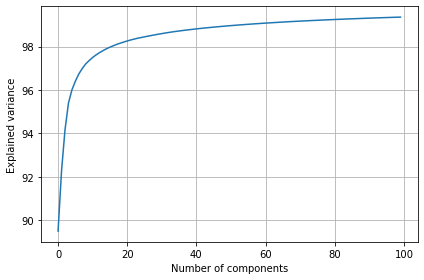

In [5]:
print(data.shape)
n_components = 100
X_pca, imgs_reduced = apply_pca(data, n_components)

In [6]:
np.random.seed(1)

In [7]:
# We have 3 different clusters:
#  * Triangle with overflow
#  * Triangle without overflow
#  * Patatoid with overflow
n = 3

In [8]:
# We classify the data with k-means
kmeans = KMeans(n_clusters=n, init='random')
kmeans.fit(X_pca)
Z = kmeans.predict(X_pca)

cluster 0, 304 elements


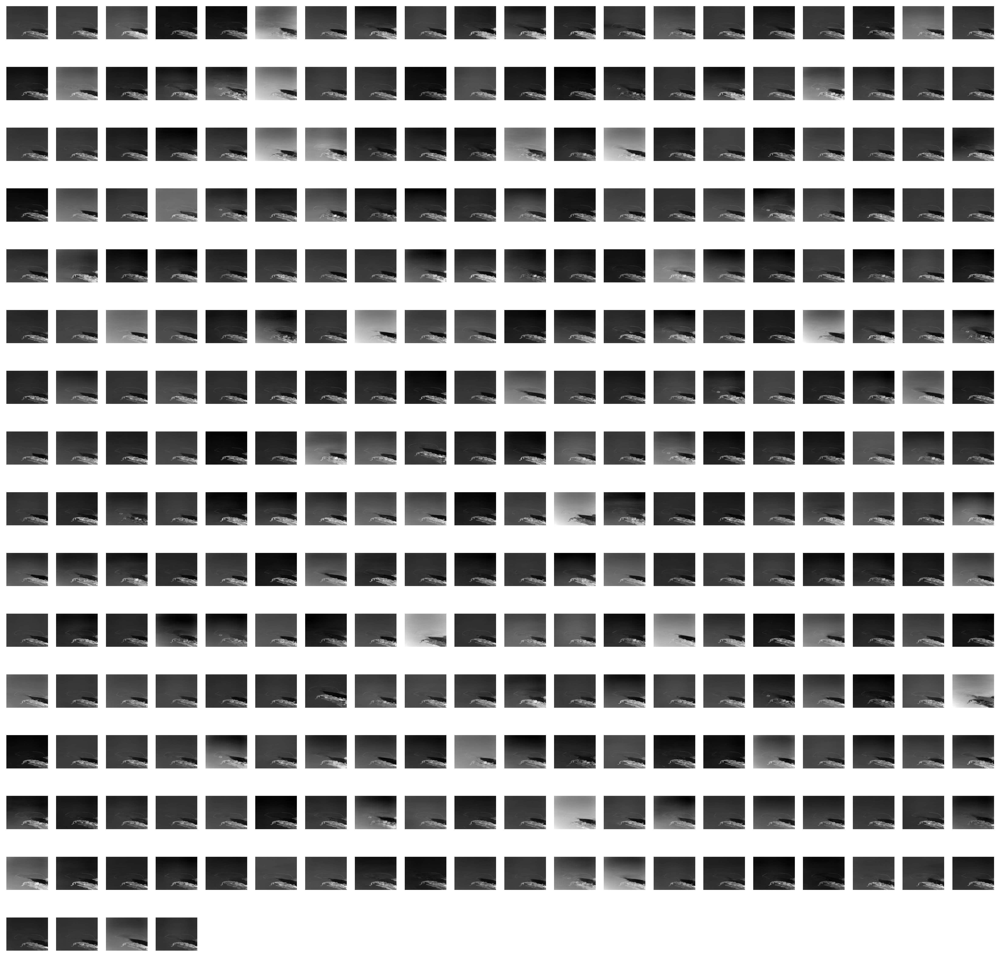

cluster 1, 242 elements


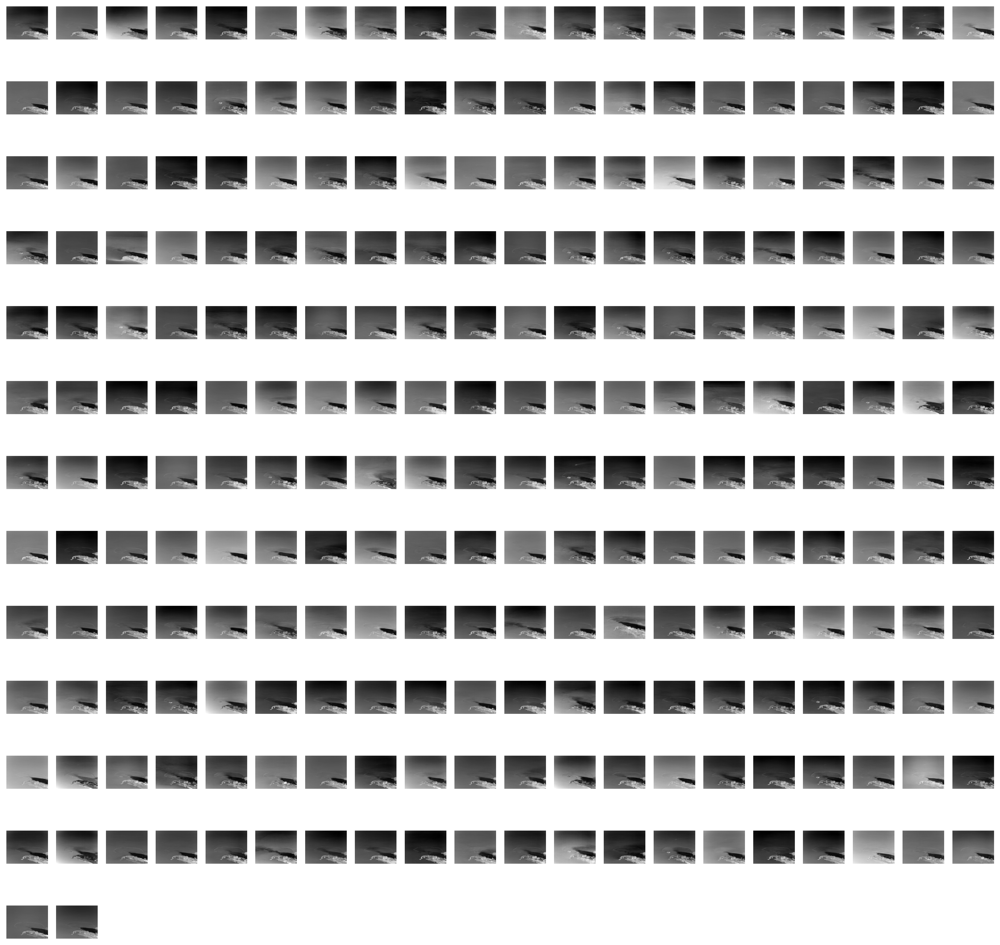

cluster 2, 234 elements


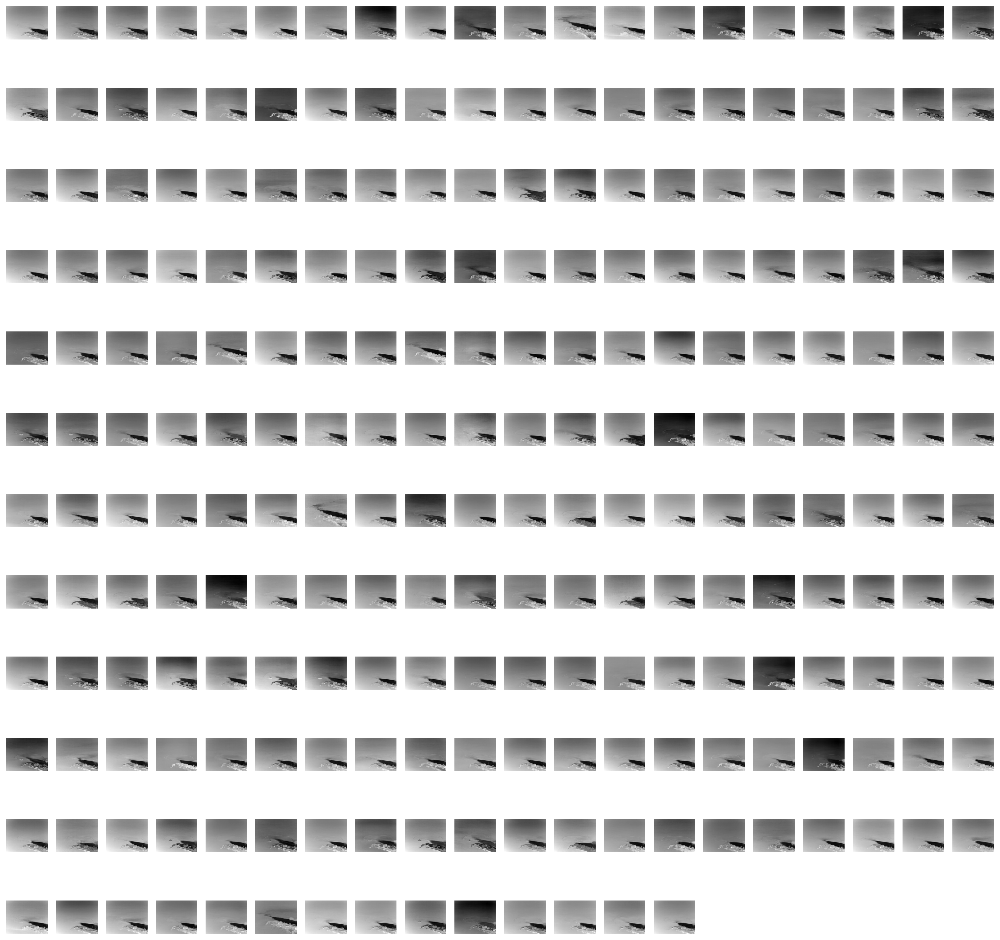

cluster 3, 0 elements


<Figure size 6000x6000 with 0 Axes>

In [9]:
# We plot the resulting clusters
size = 20
visualize(imgs_reduced, Z, size)

In [10]:
# holds the cluster id and the images { id: [images] }
groups = obtainClusters(folderSave, kmeans.labels_)

In [11]:
# print(f'Cluster 0: {groups[0]} \n')
# print(f'Cluster 1: {groups[1]} \n')
# print(f'Cluster 2: {groups[2]} \n')
# print(f'Cluster 3: {groups[3]} \n')

DBSCAN might not work well if your clusters have different densities

In [12]:
clustering = DBSCAN(eps=3000, min_samples=2).fit(X_pca)
DBSCAN_labels = clustering.labels_
infoClusters(DBSCAN_labels, n)

Number of clusters: 6
Cluster 0 contains 5 elements.
Cluster 1 contains 766 elements.
Cluster 2 contains 2 elements.


In [13]:
# We plot the resulting clusters

### Gaussian Mixture Models

In [14]:
gmm = GaussianMixture(n_components=3)
gmm = gmm.fit(X_pca)

In [15]:
# predictions from gmm
GMM_labels = gmm.predict(X_pca)

In [16]:
Z = gmm.predict(X_pca)

cluster 0, 298 elements


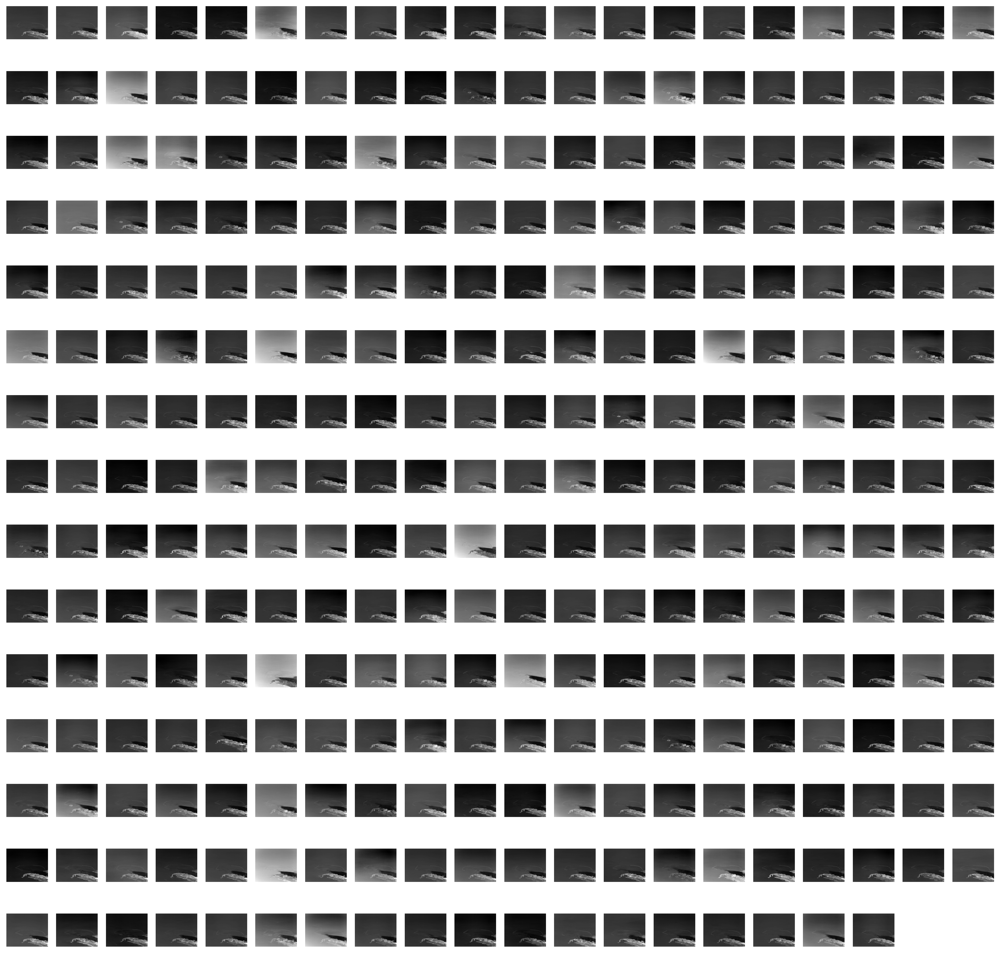

cluster 1, 254 elements


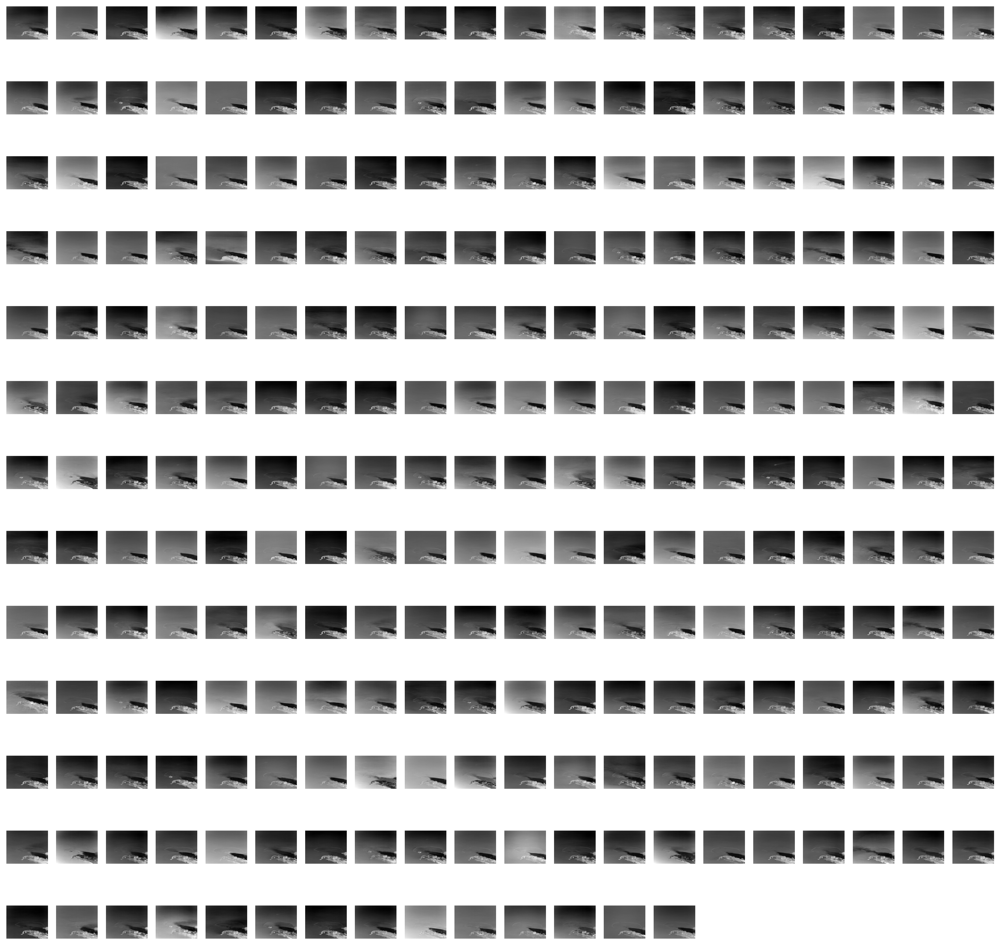

cluster 2, 228 elements


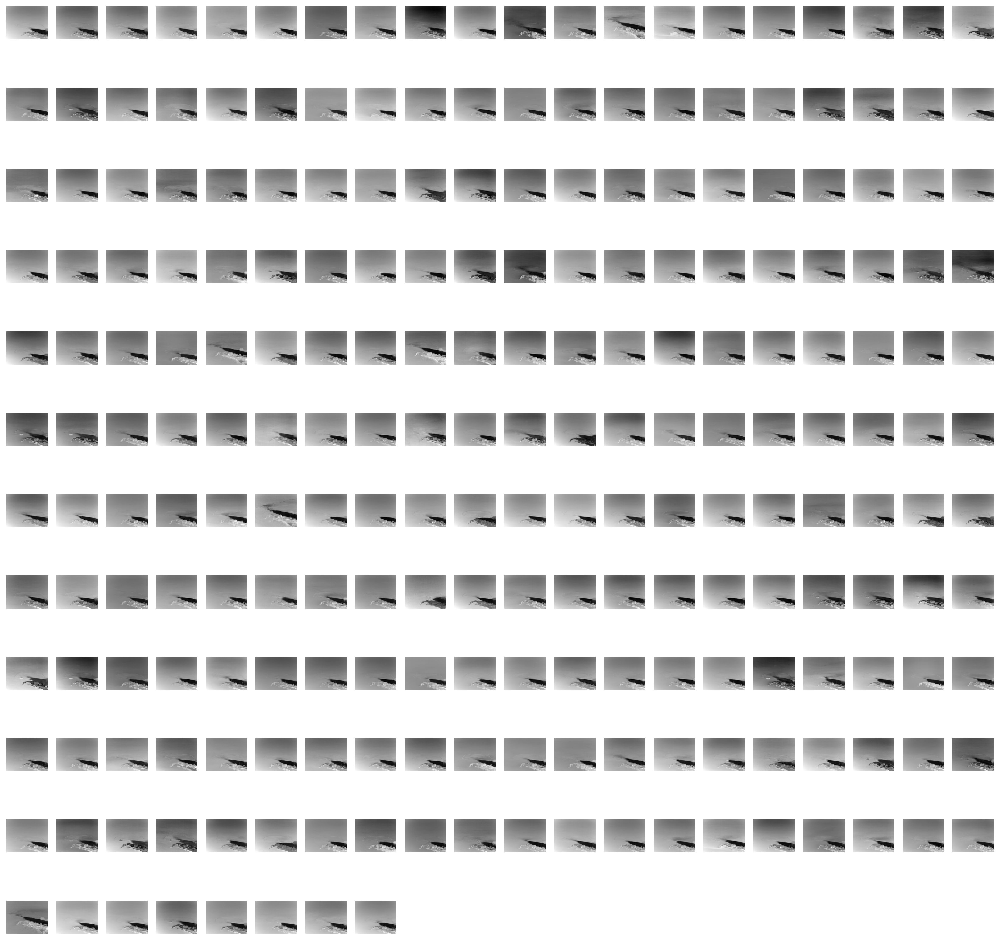

cluster 3, 0 elements


<Figure size 6000x6000 with 0 Axes>

In [17]:
# We plot the resulting clusters
size = 20
visualize(imgs_reduced, Z, size)

In [18]:
infoClusters(GMM_labels, n)

Number of clusters: 3
Cluster 0 contains 298 elements.
Cluster 1 contains 254 elements.
Cluster 2 contains 228 elements.
